<a href="https://colab.research.google.com/github/miltiadiss/MSc-Thesis/blob/main/Dataset_Exploration.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

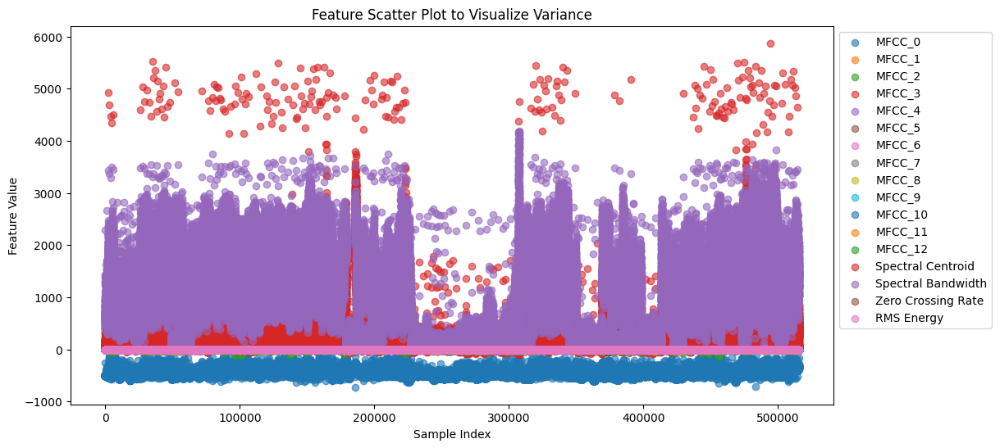

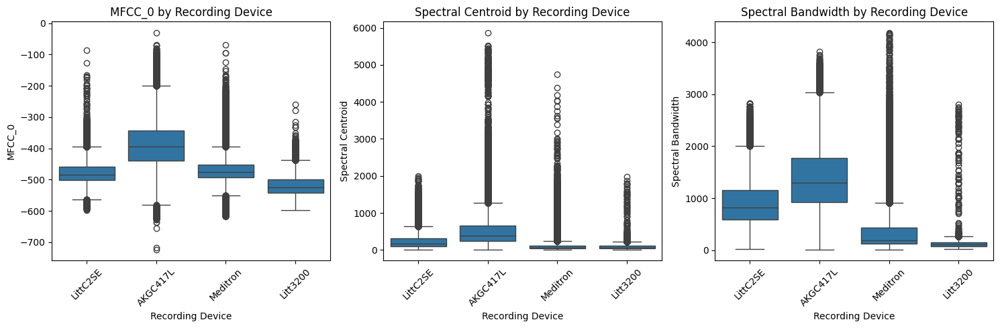

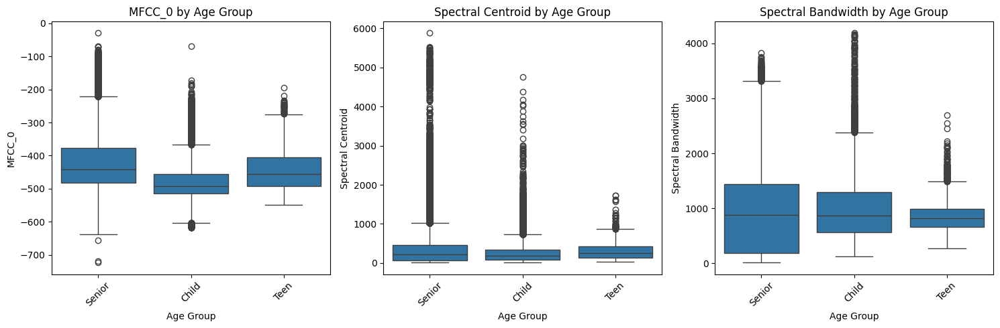

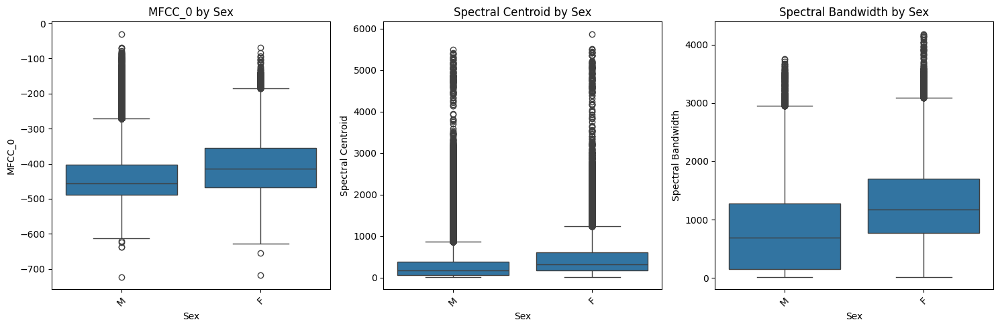

Buffered data was truncated after reaching the output size limit.

In [ ]:
import os
import librosa
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import plotly.express as px
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

# Constants
SAMPLING_RATE = 22050  # Resample the audio signals with frequency 22.05 kHz
FRAME_LENGTH = 0.04  # Set frame length equal to 40 ms
HOP_LENGTH = 0.02  # Apply 50% overlap windowing
N_MFCC = 13  # Compute the first 13 MFCCs
AUDIO_FOLDER = "/content/drive/MyDrive/Respiratory_Sound_Database/Respiratory_Sound_Database/audio_and_txt_files"
METADATA_FILE = "/content/drive/MyDrive/Respiratory_Sound_Database/Respiratory_Sound_Database/demographic_info.txt"

# Feature names
FEATURE_NAMES = [
    *(f"MFCC_{i}" for i in range(N_MFCC)),
    "Spectral Centroid", "Spectral Bandwidth", "Zero Crossing Rate", "RMS Energy"
]

# Selected features for boxplots
SELECTED_FEATURES = ["MFCC_0", "Spectral Centroid", "Spectral Bandwidth"]

def preprocess_audio(audio_path: str, sr: int = SAMPLING_RATE):
    """Preprocesses an audio file by normalizing and removing silence.

    Args:
        audio_path (str): Path to the audio file.
        sr (int): Sampling rate to resample audio.

    Returns:
        tuple: Processed audio signal and sampling rate.
    """
    y, sr = librosa.load(audio_path, sr=sr)
    y = librosa.util.normalize(y)
    y, _ = librosa.effects.trim(y, top_db=20)
    return y, sr

def extract_acoustic_features(audio_path: str, sr: int = SAMPLING_RATE,
                              frame_length: float = FRAME_LENGTH, hop_length: float = HOP_LENGTH):
    """Extracts acoustic features from an audio file.

    Args:
        audio_path (str): Path to the audio file.
        sr (int): Sampling rate.
        frame_length (float): Frame length in seconds.
        hop_length (float): Hop length for overlapping.

    Returns:
        np.ndarray: Extracted feature matrix (frames x features).
    """
    y, sr = preprocess_audio(audio_path, sr)
    frame_size = int(frame_length * sr)
    hop_size = int(hop_length * sr)

    mfccs = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=N_MFCC, n_fft=frame_size, hop_length=hop_size)
    spectral_centroid = librosa.feature.spectral_centroid(y=y, sr=sr, n_fft=frame_size, hop_length=hop_size)
    spectral_bandwidth = librosa.feature.spectral_bandwidth(y=y, sr=sr, n_fft=frame_size, hop_length=hop_size)
    zero_crossing_rate = librosa.feature.zero_crossing_rate(y, frame_length=frame_size, hop_length=hop_size)
    rms = librosa.feature.rms(y=y, frame_length=frame_size, hop_length=hop_size)

    feature_vector = np.vstack([mfccs, spectral_centroid, spectral_bandwidth, zero_crossing_rate, rms])
    return feature_vector.T

def process_all_files():
    """Extracts features from all audio files and assigns demographic metadata.

    Returns:
        pd.DataFrame: Dataframe containing extracted features and metadata.
    """
    df_metadata = pd.read_csv(METADATA_FILE, sep='\s+', header=None,
                              names=["Patient ID", "Age", "Sex", "BMI", "Weight", "Height"])

    # Define age groups
    AGE_BINS = [0, 12, 19, 50, 120]
    AGE_LABELS = ["Child", "Teen", "Adult", "Senior"]
    df_metadata["Age Group"] = pd.cut(df_metadata["Age"], bins=AGE_BINS, labels=AGE_LABELS, include_lowest=True)

    audio_files = [f for f in os.listdir(AUDIO_FOLDER) if f.endswith(".wav")]
    features_list = []
    metadata_list = []

    for file in audio_files:
        file_path = os.path.join(AUDIO_FOLDER, file)
        patient_id = int(file.split("_")[0])
        recording_device = file.split("_")[4].split(".")[0]  # Extract recording device

        feature_matrix = extract_acoustic_features(file_path)
        patient_metadata = df_metadata[df_metadata["Patient ID"] == patient_id]

        if patient_metadata.empty:
            continue  # Skip if no metadata found

        for frame in feature_matrix:
            features_list.append(frame)
            metadata = patient_metadata.iloc[0].to_dict()
            metadata["Recording Device"] = recording_device
            metadata_list.append(metadata)

    df_features = pd.DataFrame(features_list, columns=FEATURE_NAMES)
    df_metadata_expanded = pd.DataFrame(metadata_list)
    df_combined = pd.concat([df_features, df_metadata_expanded.reset_index(drop=True)], axis=1)

    return df_combined

def plot_feature_scatter(df: pd.DataFrame):
    """Plots feature variance scatter colored by feature type.

    Args:
        df (pd.DataFrame): Dataframe containing extracted features.
    """
    plt.figure(figsize=(12, 6))
    for feature in FEATURE_NAMES:
        plt.scatter(range(len(df)), df[feature], label=feature, alpha=0.6)
    plt.xlabel("Sample Index")
    plt.ylabel("Feature Value")
    plt.title("Feature Scatter Plot to Visualize Variance")
    plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
    plt.show()

def plot_feature_boxplots(df: pd.DataFrame):
    """Plots boxplots for selected features grouped by Recording Device, Age Group, and Sex.

    Args:
        df (pd.DataFrame): Dataframe containing extracted features and metadata.
    """
    for group_var in ["Recording Device", "Age Group", "Sex"]:
        plt.figure(figsize=(15, 5))
        for i, feature in enumerate(SELECTED_FEATURES):
            plt.subplot(1, 3, i + 1)
            sns.boxplot(x=group_var, y=feature, data=df)
            plt.title(f"{feature} by {group_var}")
            plt.xticks(rotation=45)
        plt.tight_layout()
        plt.show()

def apply_pca(df: pd.DataFrame, feature_columns: list, color_column: str, n_components):
    """Applies PCA to visualize feature distributions in 3D.

    Args:
        df (pd.DataFrame): Dataframe containing extracted features.
        feature_columns (list): List of feature column names.
        color_column (str): Categorical column for coloring the PCA plot.
        n_components (int, optional): Number of PCA components.
    """
    scaler = StandardScaler()
    scaled_features = scaler.fit_transform(df[feature_columns])
    pca = PCA(n_components=n_components)
    pca_result = pca.fit_transform(scaled_features)

    df_pca = pd.DataFrame(pca_result, columns=[f"PC{i+1}" for i in range(n_components)])
    df_pca[color_column] = df[color_column].values

    fig = px.scatter_3d(df_pca, x="PC1", y="PC2", z="PC3", color=df_pca[color_column].astype(str),
                         title=f"3D PCA Projection (Colored by {color_column})")
    fig.show()

def main():
    """Main function to execute the data processing and visualization steps."""
    df = process_all_files()
    plot_feature_scatter(df)

    plot_feature_boxplots(df)

    for category in ["Recording Device", "Age Group", "Sex"]:
        apply_pca(df, FEATURE_NAMES, category, n_components=17)

if __name__ == "__main__":
    main()